In [50]:
import numpy as np
import pandas as pd
import os.path as op
import itertools as it
import matplotlib.pylab as plt
from scipy.stats import pearsonr
from scipy.stats import ks_2samp
from extra import tools

In [2]:
np.load("/home/mszul/datasets/explicit_implicit_beta/derivatives/PCA_results/waveforms_clean_subset_fit.npy").shape

(2339211, 156)

In [127]:
burst_features_file = "/home/mszul/datasets/explicit_implicit_beta/derivatives/PCA_results/burst_features.csv"

In [128]:
burst_features_file

'/home/mszul/datasets/explicit_implicit_beta/derivatives/PCA_results/burst_features.csv'

In [129]:
burst_features = pd.read_csv(burst_features_file)
burst_features.columns

Index(['subject', 'epoch', 'peak_time', 'peak_freq', 'peak_amp_base',
       'fwhm_freq', 'fwhm_time', 'trial', 'pp_ix', 'block', 'PC_1', 'PC_2',
       'PC_3', 'PC_4', 'PC_5', 'PC_6', 'PC_7', 'PC_8', 'PC_9', 'PC_10',
       'PC_11', 'PC_12', 'PC_13', 'PC_14', 'PC_15', 'PC_16', 'PC_17', 'PC_18',
       'PC_19', 'PC_20'],
      dtype='object')

In [130]:
burst_features.index

RangeIndex(start=0, stop=14328947, step=1)

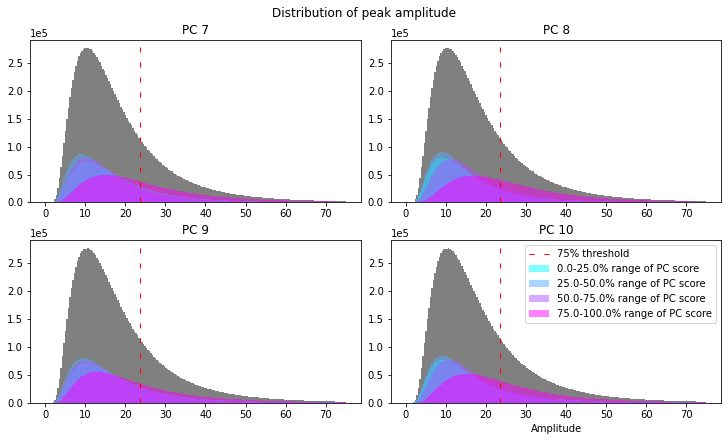

In [75]:
PC_to_analyse = ["PC_7", "PC_8", "PC_9", "PC_10"]
col_r = plt.cm.cool(np.linspace(0,1, num=4))
prct = np.linspace(0,100, num=5)
prct_ranges = list(zip(prct[:-1], prct[1:]))
pos_ = list(it.product([1,2], [1,2]))

f, ax = plt.subplots(2, 2, figsize=(10, 6), constrained_layout=True)

pos_ = list(it.product([0,1], [0,1]))

for pc_ix, pos in enumerate(pos_):
    ax[pos].hist(burst_features["peak_amp_base"]/1e-15, range=(0,75), bins=200, color="gray");
    ax[pos].axvline(np.percentile(burst_features["peak_amp_base"]/1e-15, 75), lw=1, color="red", linestyle=(0, (5, 10)), label="75% threshold")

    for ix, (b, e) in enumerate(prct_ranges):
        low_ = np.percentile(burst_features[PC_to_analyse[pc_ix]], b)
        upp_ = np.percentile(burst_features[PC_to_analyse[pc_ix]], e)
        sel_pow = burst_features.loc[
            (burst_features[PC_to_analyse[pc_ix]] >= low_) &
            (burst_features[PC_to_analyse[pc_ix]] <= upp_)
        ]["peak_amp_base"]/1e-15
        label = "{}-{}% range of PC score".format(b, e)
        ax[pos].hist(sel_pow, range=(0,75), bins=200, color=col_r[ix], alpha=0.5, label=label);
    pc_name = " ".join(PC_to_analyse[pc_ix].split("_"))
    ax[pos].set_title(pc_name)
    ax[pos].ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    # ax[pos].set_xlim(0, 0.1*1e-12)
ax[1,1].legend()
ax[1,1].set_xlabel("Amplitude")
f.suptitle("Distribution of peak amplitude")
plt.savefig("/scratch/BURST_PAPER/supplementary_PC_dist_peak_amp.svg")

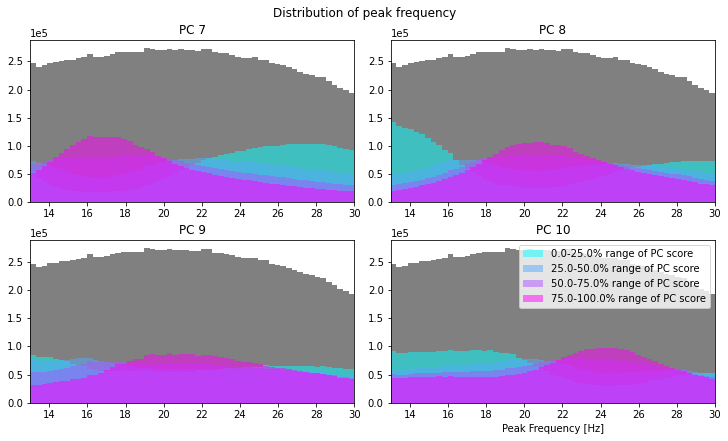

In [68]:
PC_to_analyse = ["PC_7", "PC_8", "PC_9", "PC_10"]
col_r = plt.cm.cool(np.linspace(0,1, num=4))
prct = np.linspace(0,100, num=5)
prct_ranges = list(zip(prct[:-1], prct[1:]))
pos_ = list(it.product([1,2], [1,2]))

f, ax = plt.subplots(2, 2, figsize=(10, 6), constrained_layout=True)

pos_ = list(it.product([0,1], [0,1]))

for pc_ix, pos in enumerate(pos_):
    ax[pos].hist(burst_features["peak_freq"], bins=57, range=(13,30), color="gray");

    for ix, (b, e) in enumerate(prct_ranges):
        low_ = np.percentile(burst_features[PC_to_analyse[pc_ix]], b)
        upp_ = np.percentile(burst_features[PC_to_analyse[pc_ix]], e)
        sel_pow = burst_features.loc[
            (burst_features[PC_to_analyse[pc_ix]] >= low_) &
            (burst_features[PC_to_analyse[pc_ix]] <= upp_)
        ]["peak_freq"]
        label = "{}-{}% range of PC score".format(b, e)
        ax[pos].hist(sel_pow, bins=57, range=(13,30), color=col_r[ix], alpha=0.5, label=label);
    pc_name = " ".join(PC_to_analyse[pc_ix].split("_"))
    ax[pos].set_title(pc_name)
    ax[pos].ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    ax[pos].set_xlim(13,30)
ax[1,1].legend()
ax[1,1].set_xlabel("Peak Frequency [Hz]")
f.suptitle("Distribution of peak frequency")
plt.savefig("/scratch/BURST_PAPER/supplementary_PC_dist_peak_freq.svg")

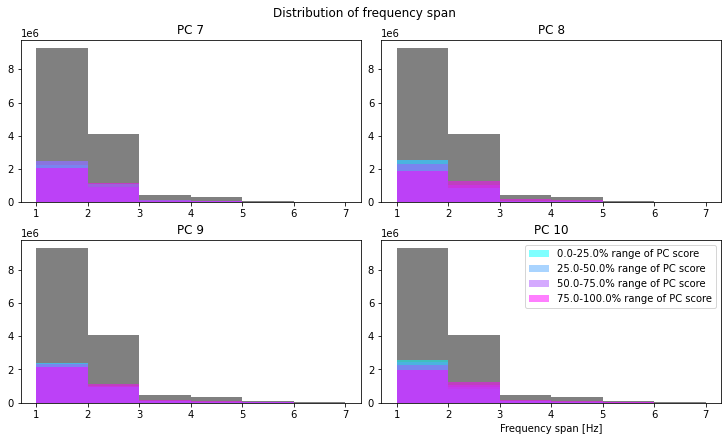

In [67]:
PC_to_analyse = ["PC_7", "PC_8", "PC_9", "PC_10"]
col_r = plt.cm.cool(np.linspace(0,1, num=4))
prct = np.linspace(0,100, num=5)
prct_ranges = list(zip(prct[:-1], prct[1:]))
pos_ = list(it.product([1,2], [1,2]))

f, ax = plt.subplots(2, 2, figsize=(10, 6), constrained_layout=True)

pos_ = list(it.product([0,1], [0,1]))

for pc_ix, pos in enumerate(pos_):
    ax[pos].hist(burst_features["fwhm_freq"], bins=6, range=(1,7), color="gray");

    for ix, (b, e) in enumerate(prct_ranges):
        low_ = np.percentile(burst_features[PC_to_analyse[pc_ix]], b)
        upp_ = np.percentile(burst_features[PC_to_analyse[pc_ix]], e)
        sel_pow = burst_features.loc[
            (burst_features[PC_to_analyse[pc_ix]] >= low_) &
            (burst_features[PC_to_analyse[pc_ix]] <= upp_)
        ]["fwhm_freq"]
        label = "{}-{}% range of PC score".format(b, e)
        ax[pos].hist(sel_pow, bins=6, range=(1,7), color=col_r[ix], alpha=0.5, label=label);
    pc_name = " ".join(PC_to_analyse[pc_ix].split("_"))
    ax[pos].set_title(pc_name)
    ax[pos].ticklabel_format(style='sci', axis='y', scilimits=(0,0))
ax[1,1].legend()
ax[1,1].set_xlabel("Frequency span [Hz]")
f.suptitle("Distribution of frequency span")
plt.savefig("/scratch/BURST_PAPER/supplementary_PC_dist_freq_span.svg")

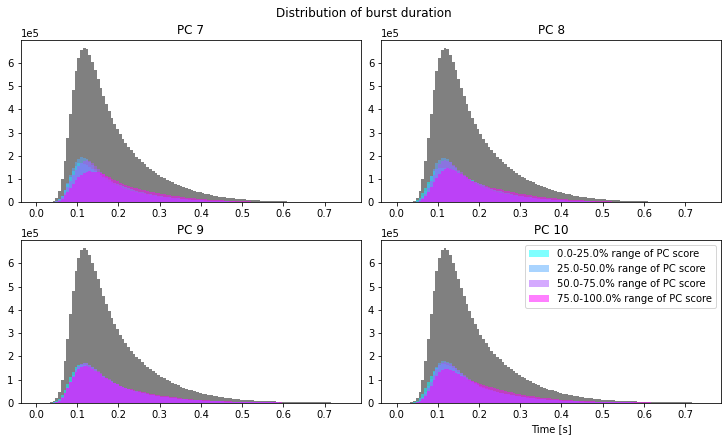

In [66]:
PC_to_analyse = ["PC_7", "PC_8", "PC_9", "PC_10"]
col_r = plt.cm.cool(np.linspace(0,1, num=4))
prct = np.linspace(0,100, num=5)
prct_ranges = list(zip(prct[:-1], prct[1:]))
pos_ = list(it.product([1,2], [1,2]))

f, ax = plt.subplots(2, 2, figsize=(10, 6), constrained_layout=True)

pos_ = list(it.product([0,1], [0,1]))

for pc_ix, pos in enumerate(pos_):
    ax[pos].hist(burst_features["fwhm_time"], bins=112, range=(0, 0.75), color="gray");

    for ix, (b, e) in enumerate(prct_ranges):
        low_ = np.percentile(burst_features[PC_to_analyse[pc_ix]], b)
        upp_ = np.percentile(burst_features[PC_to_analyse[pc_ix]], e)
        sel_pow = burst_features.loc[
            (burst_features[PC_to_analyse[pc_ix]] >= low_) &
            (burst_features[PC_to_analyse[pc_ix]] <= upp_)
        ]["fwhm_time"]
        label = "{}-{}% range of PC score".format(b, e)
        ax[pos].hist(sel_pow, bins=112, range=(0, 0.75), color=col_r[ix], alpha=0.5, label=label);
    pc_name = " ".join(PC_to_analyse[pc_ix].split("_"))
    ax[pos].set_title(pc_name)
    ax[pos].ticklabel_format(style='sci', axis='y', scilimits=(0,0))
ax[1,1].legend()
ax[1,1].set_xlabel("Time [s]")
f.suptitle("Distribution of burst duration")
plt.savefig("/scratch/BURST_PAPER/supplementary_PC_dist_duration.svg")

In [76]:
all_PCs = ["PC_{}".format(i) for i in range(1,21)]

In [164]:

pc_ix = 0
pc_key = all_PCs[pc_ix]
f, ax = plt.subplots(20, 4, figsize=(20, 20*4), constrained_layout=True, dpi=300)
ax[0, 0].set_title("Peak Amplitude")
ax[0, 1].set_title("Peak Frequency")
ax[0, 2].set_title("Frequency span")
ax[0, 3].set_title("Duration")
for pc_ix, pc_key in enumerate(all_PCs):
    pc_name = " ".join([*pc_key.split("_"), "score"])
    ax[pc_ix, 0].set_ylabel(pc_name)
    for col_ix, ft in enumerate(["peak_amp_base", "peak_freq", "fwhm_freq", "fwhm_time"]):
        div = 1
        if ft == "peak_amp_base":
            div=1e-15
        ax[pc_ix, col_ix].scatter(
            burst_features[ft][::1000]/div, burst_features[pc_key][::1000], 
            s=25, marker="o", c="gray", edgecolors="black", alpha=0.25, rasterized=True)
        lims = ax[pc_ix, col_ix].get_xlim()
        r, pv = pearsonr(burst_features[ft]/div, burst_features[pc_key])
        r = np.round(r, 3)
        pv = np.round(pv, 3)
        x = np.linspace(*lims, num=25)
        z = np.polyfit(burst_features[ft]/div, burst_features[pc_key], 1)
        p = np.poly1d(z)
        y = p(x)
        ax[pc_ix, col_ix].plot(x, y, lw=1, c="black")
        ax[pc_ix, col_ix].annotate("r = {}\np = {}".format(r, pv), xy=(0.8, 0.8), xycoords="axes fraction")
ax[19, 0].set_xlabel("Peak Amplitude [fT]")
ax[19, 1].set_xlabel("Peak Frequency [Hz]")
ax[19, 2].set_xlabel("Frequency Span [Hz]")
ax[19, 3].set_xlabel("Duration [s]")
plt.savefig("/scratch/BURST_PAPER/supplementary_PC_feature_corr.svg")

In [12]:
vis = burst_features.loc[burst_features.epoch =="vis"].fwhm_time
mot = burst_features.loc[burst_features.epoch =="mot"].fwhm_time
print("DURATION")
print(ks_2samp(vis, mot))
print(np.mean(vis), np.std(vis))
print(np.mean(mot), np.std(mot))
print(np.mean(burst_features.fwhm_time), np.std(burst_features.fwhm_time))

DURATION
KstestResult(statistic=0.00896552720830096, pvalue=2.0177977396081234e-248)
0.18572960640669905 0.09735936161844372
0.18421733590722142 0.09695644357294597
0.18504292604334813 0.09717953159457993


In [13]:
vis = burst_features.loc[burst_features.epoch =="vis"].fwhm_freq
mot = burst_features.loc[burst_features.epoch =="mot"].fwhm_freq
print("FREQ SPAN")
print(ks_2samp(vis, mot))
print(np.mean(vis), np.std(vis))
print(np.mean(mot), np.std(mot))
print(np.mean(burst_features.fwhm_freq), np.std(burst_features.fwhm_freq))

FREQ SPAN
KstestResult(statistic=0.006509729878341086, pvalue=3.60813574636236e-131)
2.013147324217404 0.8177891350655376
2.0066521103739277 0.8190979745914515
2.0101980265860533 0.8183900918502103


In [14]:
vis = burst_features.loc[burst_features.epoch =="vis"].peak_amp_base/1e-15
mot = burst_features.loc[burst_features.epoch =="mot"].peak_amp_base/1e-15
print("Amplitude")
print(ks_2samp(vis, mot))
print(np.mean(vis), np.std(vis))
print(np.mean(mot), np.std(mot))
print(np.mean(burst_features.peak_amp_base/1e-15), np.std(burst_features.peak_amp_base/1e-15))

Amplitude
KstestResult(statistic=0.016430953812662408, pvalue=0.0)
18.97456974693672 13.06034758767208
18.825185790826115 13.24639259438861
18.906738608726847 13.145362276851266


In [15]:
vis = burst_features.loc[burst_features.epoch =="vis"].peak_freq
mot = burst_features.loc[burst_features.epoch =="mot"].peak_freq
print("PEAK FREQ")
print(ks_2samp(vis, mot))
print(np.mean(vis), np.std(vis))
print(np.mean(mot), np.std(mot))
print(np.mean(burst_features.peak_freq), np.std(burst_features.peak_freq))

PEAK FREQ
KstestResult(statistic=0.004560960918804979, pvalue=1.316604127236005e-64)
21.370004590788998 4.753139070231341
21.333355441188264 4.762861773564115
21.353363221818974 4.757591336952632


In [29]:
summary = burst_features.groupby(["subject","epoch", "block", "pp_ix"])["peak_time"].count().reset_index()
summary.columns = ["subject", "epoch_type", "block", "trial_index", "burst_per_trial"]

summary.to_csv("/home/mszul/datasets/explicit_implicit_beta/derivatives/PCA_results/burst_summary_per_trial_sum.csv")

In [ ]:
summary = burst_features[["subject","epoch",  "pp_ix","peak_time"]]
summary.columns = ["subject", "epoch_type", "block", "peak_time"]
summary["burst"] = 1

summary.to_csv("/home/mszul/datasets/explicit_implicit_beta/derivatives/PCA_results/burst_summary_per_trial.csv", index=False)

In [96]:
nice_labels = {
    "peak_amp_base": "Amplitude",
    "peak_freq": "Peak Frequency",
    "fwhm_freq": "Frequency Span",
    "fwhm_time": "Duration"
}

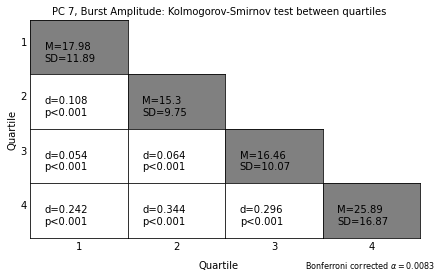

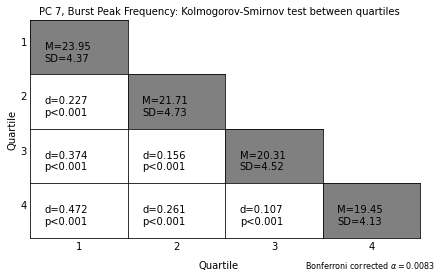

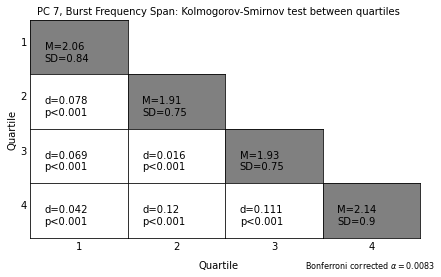

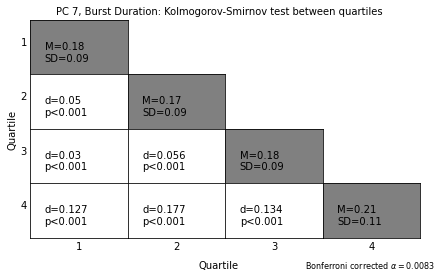

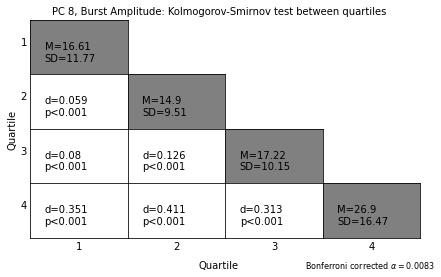

...

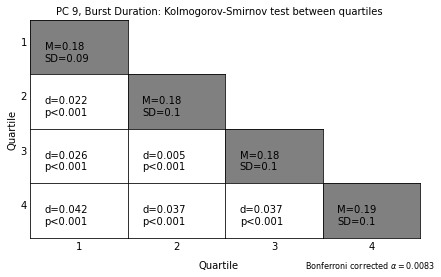

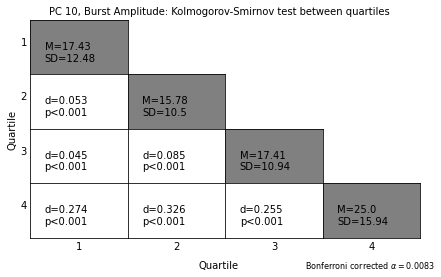

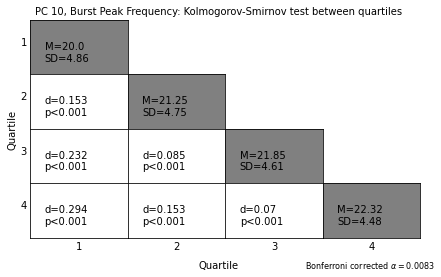

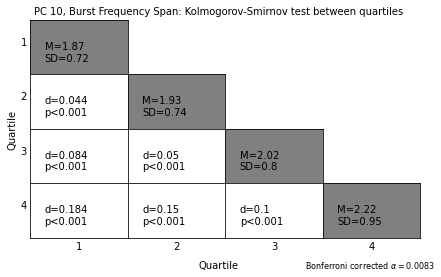

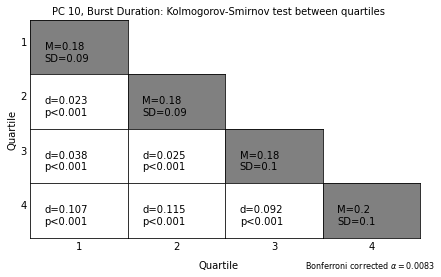

In [150]:
PC_to_analyse = ["PC_7", "PC_8", "PC_9", "PC_10"]
prct = np.linspace(0,100, num=5)
prct_ranges = list(zip(prct[:-1], prct[1:]))
for pc_ix, pc_key in enumerate(PC_to_analyse):
    PC_label = " ".join(pc_key.split("_"))
    for col_ix, ft in enumerate(["peak_amp_base", "peak_freq", "fwhm_freq", "fwhm_time"]):
        DATA = {}
        for ix, (b, e) in enumerate(prct_ranges):
            low_ = np.percentile(burst_features[pc_key], b)
            upp_ = np.percentile(burst_features[pc_key], e)
            sel_pow = burst_features.loc[
                (burst_features[PC_to_analyse[pc_ix]] >= low_) &
                (burst_features[PC_to_analyse[pc_ix]] <= upp_)
            ][ft]
            DATA[ix] = sel_pow
        
        full = list(it.combinations_with_replacement(range(4), 2))
        comb = list(it.combinations(range(4), 2))

        fig = plt.figure(figsize=(7, 4), constrained_layout=False, facecolor="white")
        grid = fig.add_gridspec(4, 4, wspace=0, hspace=0)

        for c, r in full:
            xx = grid[r, c].subgridspec(1,1)
            ax = xx.subplots()
            ax.set_xticks([])
            ax.set_yticks([])
            if r == 3:
                ax.set_xlabel("{}".format(c+1))
            if c == 0:
                ax.set_ylabel("{} ".format(r+1), rotation=0)
            if r == c:
                div=1
                if ft == "peak_amp_base":
                    div = 1e-15
                mean = np.round(np.mean(DATA[r]/div), 2)
                std = np.round(np.std(DATA[r]/div), 2)
                ax.set_facecolor("gray")
                ax.annotate(
                    xy=(0.15,0.25),
                    text="M={}\nSD={}".format(
                        mean, std
                    )
                )
            if (c, r) in comb:
                d, p = ks_2samp(DATA[r], DATA[c])
                ax.annotate(xy=(0.15,0.25), text="d={}\np<0.001".format(np.round(d, 3)))
        fig.text(0.5, 0.02, "Quartile", ha="center")
        fig.text(0.08, 0.5, "Quartile", va="center", rotation="vertical")
        fig.text(0.5, 0.9, "{}, Burst {}: Kolmogorov-Smirnov test between quartiles".format(PC_label, nice_labels[ft]), ha="center")
        fig.text(0.67, 0.02, r"Bonferroni corrected $\alpha = 0.0083$", ha="left", fontsize=8)
        plt.savefig("/scratch/BURST_PAPER/update_supplementary_{}_feature_quartile_KS_{}.svg".format(pc_key, ft))

[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]

Text(0.67, 0.02, 'Bonferroni corrected $\\alpha = 0.0083$')

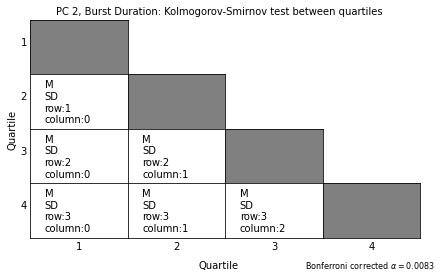

In [148]:
PC_label = "PC 2"

full = list(it.combinations_with_replacement(range(4), 2))
comb = list(it.combinations(range(4), 2))

fig = plt.figure(figsize=(7, 4), constrained_layout=False, facecolor="white")
grid = fig.add_gridspec(4, 4, wspace=0, hspace=0)

for c, r in full:
    xx = grid[r, c].subgridspec(1,1)
    ax = xx.subplots()
    ax.set_xticks([])
    ax.set_yticks([])
    if r == 3:
        ax.set_xlabel("{}".format(c+1))
    if c == 0:
        ax.set_ylabel("{} ".format(r+1), rotation=0)
    if r == c:
        ax.set_facecolor("gray")
    if (c, r) in comb:
        ax.annotate(xy=(0.15,0.12), text="M\nSD\nrow:{}\ncolumn:{}".format(r, c), )
fig.text(0.5, 0.02, "Quartile", ha="center")
fig.text(0.08, 0.5, "Quartile", va="center", rotation="vertical")
fig.text(0.5, 0.9, "{}, Burst {}: Kolmogorov-Smirnov test between quartiles".format(PC_label, nice_labels["fwhm_time"]), ha="center")
fig.text(0.67, 0.02, r"Bonferroni corrected $\alpha = 0.0083$", ha="left", fontsize=8)